In [15]:
import tensorflow as tf
#import tensorflow_addons as tfa
import json
import os
import pickle
import tensorflow
import numpy as np
import string, os
import nltk
nltk.download('genesis')
nltk.download('nps_chat')
nltk.download('webtext')
nltk.download('treebank')
from nltk.book import *
from gensim.models import KeyedVectors
import gensim.downloader as api
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input, Dropout, LSTM, Activation, Bidirectional, BatchNormalization
from tensorflow.keras.layers import Embedding
from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.callbacks import LambdaCallback, ModelCheckpoint
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import tensorflow.keras.utils as ku
from sklearn.model_selection import train_test_split
import random
import sys
from datetime import date
from collections import Counter
import matplotlib.pyplot as plt
os.chdir('../')
from src.features.build import Lyrics
from src.features.transform_data import Transform
physical_devices = tf.config.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], enable=True)
today = date.today()
# Load vectors directly from the file
word_vectors = api.load("glove-twitter-50")

[nltk_data] Downloading package genesis to /home/joels/nltk_data...
[nltk_data]   Package genesis is already up-to-date!
[nltk_data] Downloading package nps_chat to /home/joels/nltk_data...
[nltk_data]   Package nps_chat is already up-to-date!
[nltk_data] Downloading package webtext to /home/joels/nltk_data...
[nltk_data]   Package webtext is already up-to-date!
[nltk_data] Downloading package treebank to /home/joels/nltk_data...
[nltk_data]   Package treebank is already up-to-date!


In [2]:
def clean_text(txt):
    txt = "".join(v for v in txt if v not in string.punctuation).lower()
    txt = txt.encode("utf8").decode("ascii",'ignore')
    return txt
_t = Transform()
lyrics = _t.verse_lines
print(lyrics[0])
arr = np.array(lyrics)

['16th chamber temple number five', 'somebody said its on if it is then ill be set', 'to blow a nigga up with my five fingers of death', 'i bring it to his whole damn fam understand', 'if he frontin on any man down with the clan', 'i be comin for that headpiece you cant cope', 'for my brother i even kill a pope word to mother', 'serial killa style from the isle of stat', 'my peoples are you with me where you at', 'shits gettin deep in here i mean like thick', 'niggas lookin all in my face like they want dick', 'its about to hit the fan hit the flo', 'thats all i can stands and i cant stands no mo', 'what is it niggas think they bigga', 'because they got the finga on the trigga of a biscuit', 'they dont know im wicked when i start to kick it', 'with the raw sound wash it down with a mystic', 'better yet a snapple nigga want the juice', 'but he dont want the hassle', 'thought they trying to overthrow the castle', 'better yet the temple im comin to your town', 'black down the rental car t

In [3]:
from __future__ import division
len(text3) / len(set(text3)) # lexical richness

text3.count("smote")

100 * text4.count('a') / len(text4)

def lexical_diversity(text):
    return len(text) / len(set(text))

def percentage(word, text):
    return 100 * text.count(word) / len(text)

def percentage(word, text):
    return 100 * text.count(word) / len(text)

In [4]:
flat_lyrics = [y for x in lyrics for y in x]
join_lyrics = " ".join(flat_lyrics).split()
lexical_diversity(join_lyrics)
len(join_lyrics) / len(set(join_lyrics))

71.02876304023845

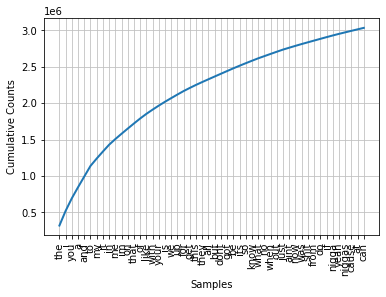

In [5]:
fdist1 = FreqDist(join_lyrics)
vocabulary1 = fdist1.keys()

fdist1.plot(50, cumulative=True)

In [6]:
len(fdist1.hapaxes())

44269

In [7]:
V = set(join_lyrics)
long_words = [w for w in V if len(w) > 15]
sorted(long_words)

def words_of_length(length, text):
    V = set(text)
    long_words = [w for w in V if len(w) > 15]
    return sorted(long_words)

fdist5 = FreqDist(text5)
fdist5

FreqDist({'.': 1268, 'JOIN': 1021, 'PART': 1016, '?': 737, 'lol': 704, 'to': 658, 'i': 648, 'the': 646, 'you': 635, ',': 596, ...})

In [8]:
## Takend from blog post https://www.kdnuggets.com/2018/03/text-data-preprocessing-walkthrough-python.html
from tqdm import tqdm
import re, string, unicodedata
import nltk
import contractions
import inflect
from bs4 import BeautifulSoup
from nltk import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import LancasterStemmer, WordNetLemmatizer
join_lyrics = " ".join(flat_lyrics)
def remove_non_ascii(words):
    """Remove non-ASCII characters from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = unicodedata.normalize('NFKD', word).encode('ascii', 'ignore').decode('utf-8', 'ignore')
        new_words.append(new_word)
    return new_words

def to_lowercase(words):
    """Convert all characters to lowercase from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = word.lower()
        new_words.append(new_word)
    return new_words

def remove_punctuation(words):
    """Remove punctuation from list of tokenized words"""
    new_words = []
    for word in words:
        new_word = re.sub(r'[^\w\s]', '', word)
        if new_word != '':
            new_words.append(new_word)
    return new_words

def replace_numbers(words):
    """Replace all interger occurrences in list of tokenized words with textual representation"""
    p = inflect.engine()
    new_words = []
    for word in words:
        if word.isdigit():
            new_word = p.number_to_words(word)
            new_words.append(new_word)
        else:
            new_words.append(word)
    return new_words

def remove_stopwords(words):
    """Remove stop words from list of tokenized words"""
    new_words = []
    for word in words:
        if word not in stopwords.words('english'):
            new_words.append(word)
    return new_words

def stem_words(words):
    """Stem words in list of tokenized words"""
    stemmer = LancasterStemmer()
    stems = []
    for word in words:
        stem = stemmer.stem(word)
        stems.append(stem)
    return stems

def lemmatize_verbs(words):
    """Lemmatize verbs in list of tokenized words"""
    lemmatizer = WordNetLemmatizer()
    lemmas = []
    for word in words:
        lemma = lemmatizer.lemmatize(word, pos='v')
        lemmas.append(lemma)
    return lemmas

def normalize(words):
    words = remove_non_ascii(words)
    words = to_lowercase(words)
    words = remove_punctuation(words)
    words = replace_numbers(words)
    words = remove_stopwords(words)
    words = lemmatize_verbs(words)
    return words

#print('Number of tokens (before pipeline): {0}'.format(len(set(nltk.word_tokenize(join_lyrics)))))
normalized_lyrics = list()
for verse in tqdm(lyrics):
    verse_tmp = list()
    for line in verse:
        verse_tmp.append(" ".join(normalize(line.split(" "))))
    normalized_lyrics.append(verse_tmp)

#test_processed_lyrics = nltk.word_tokenize(" ".join([y for x in normalized_lyrics for y in x]))
#print('Number of tokens (after pipeline): {0}'.format(len(set(test_processed_lyrics))))


100%|██████████| 13789/13789 [07:57<00:00, 28.86it/s]


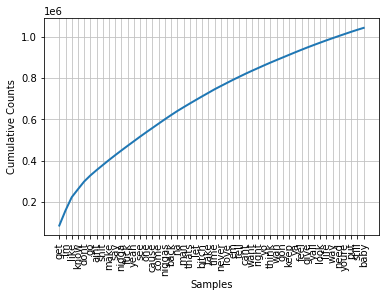

In [9]:
fdist1 = FreqDist(nltk.word_tokenize(" ".join([y for x in normalized_lyrics for y in x])))
vocabulary1 = fdist1.keys()

fdist1.plot(50, cumulative=True)

In [10]:
" ".join([y for x in normalized_lyrics for y in x])

'16th chamber temple number five somebody say ill set blow nigga five finger death bring whole damn fam understand frontin man clan comin headpiece cant cope brother even kill pope word mother serial killa style isle stat people shit gettin deep mean like thick niggas lookin face like want dick hit fan hit flo thats stand cant stand mo niggas think bigga get finga trigga biscuit dont know im wicked start kick raw sound wash mystic better yet snapple nigga want juice dont want hassle think try overthrow castle better yet temple im comin town black rental car pistol yah dont want burn glock beware buck shots mean buck stop dough make unless make 16ooh method man chamber four 16ooh chamber four temple number nine temple number nine im original god make young ladies scream specialty go oohwah oohwah oohwah girls wanna get hype funky fresh music stereotype kill ol mad rugged flow sayin ason like duck disco disco duck im strictly hip hop yo ason whats cant stop wutanging flip script could te

In [11]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
# from tensorflow.keras.layers.advanced_activations import ELU
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from scipy import spatial

tokenizer = Tokenizer()
corpus = [" ".join(x) for x in normalized_lyrics]

def get_sequence_of_tokens(corpus):
    ## tokenization
    tokenizer.fit_on_texts(corpus)
    total_words = len(tokenizer.word_index) + 1
    print(f'Number of words before downsampling: {total_words}')
    count_thres = 1
    #low_count_words = [w for w,c in tokenizer.word_counts.items() if c < count_thres]
    #for w in low_count_words:
    #    del tokenizer.word_index[w]
    #    del tokenizer.word_docs[w]
    #    del tokenizer.word_counts[w]
    total_words = len(tokenizer.word_index) + 1
    print(f'Number of words after downsampling: {total_words}')
    # convert data to sequence of tokens
    input_sequences = []
    for line in corpus:
        token_list = tokenizer.texts_to_sequences([line])[0]
        for i in range(1, len(token_list)):
            n_gram_sequence = token_list[:i+1]
            input_sequences.append(n_gram_sequence)
    return input_sequences, total_words
inp_sequences, total_words = get_sequence_of_tokens(corpus)


Number of words before downsampling: 88771
Number of words after downsampling: 88771


In [12]:
corpus

['16th chamber temple number five somebody say ill set blow nigga five finger death bring whole damn fam understand frontin man clan comin headpiece cant cope brother even kill pope word mother serial killa style isle stat people shit gettin deep mean like thick niggas lookin face like want dick hit fan hit flo thats stand cant stand mo niggas think bigga get finga trigga biscuit dont know im wicked start kick raw sound wash mystic better yet snapple nigga want juice dont want hassle think try overthrow castle better yet temple im comin town black rental car pistol yah dont want burn glock beware buck shots mean buck stop dough make unless make 16ooh method man chamber four 16ooh chamber four temple number nine temple number nine im original god make young ladies scream specialty go oohwah oohwah oohwah girls wanna get hype funky fresh music stereotype kill ol mad rugged flow sayin ason like duck disco disco duck im strictly hip hop yo ason whats cant stop wutanging flip script could t

In [14]:
def pretrained_embedding_layer(word_to_vec_map, word_to_index):
    """
    Creates a Keras Embedding() layer and loads in pre-trained GloVe 50-dimensional vectors.

    Arguments:
    word_to_vec_map -- dictionary mapping words to their GloVe vector representation.
    word_to_index -- dictionary mapping from words to their indices in the vocabulary (400,001 words)

    Returns:
    embedding_layer -- pretrained layer Keras instance
    """

    vocab_len = len(word_to_index) + 1                  # adding 1 to fit Keras embedding (requirement)
    emb_dim = word_vectors.get_vector("cucumber").shape[0]      # define dimensionality of your GloVe word vectors (= 50)
    emb_dim_one = word_vectors.get_vector("cucumber").shape

    ### START CODE HERE ###
    # Step 1
    # Initialize the embedding matrix as a numpy array of zeros.
    # See instructions above to choose the correct shape.
    emb_matrix = np.zeros((vocab_len, emb_dim))

    # Step 2
    # Set each row "idx" of the embedding matrix to be
    # the word vector representation of the idx'th word of the vocabulary
    for word, idx in word_to_index.items():
        try:
            emb_matrix[idx, :] = word_vectors.get_vector(word)
        except KeyError:
            emb_matrix[idx, :] = np.zeros(word_vectors.get_vector("cucumber").shape)

    # Step 3
    # Define Keras embedding layer with the correct input and output sizes
    # Make it non-trainable.
    embedding_layer = tensorflow.keras.layers.Embedding(input_dim=vocab_len, output_dim=emb_dim, trainable=True, mask_zero=True)
    ### END CODE HERE ###

    # Step 4 (already done for you; please do not modify)
    # Build the embedding layer, it is required before setting the weights of the embedding layer.
    embedding_layer.build((None,)) # Do not modify the "None".  This line of code is complete as-is.

    # Set the weights of the embedding layer to the embedding matrix. Your layer is now pretrained.
    embedding_layer.set_weights([emb_matrix])

    return embedding_layer



embedding = pretrained_embedding_layer(word_vectors, tokenizer.word_index)
input_shape = (max_sequence_len,64)
print(max_sequence_len)
sentence_indices = Input(shape=input_shape, dtype='int32')

# Create the embedding layer pretrained with GloVe Vectors (≈1 line)
embedding_layer = pretrained_embedding_layer(word_vectors, tokenizer.word_index)

# Propagate sentence_indices through your embedding layer
# (See additional hints in the instructions).
embeddings = embedding_layer(sentence_indices)


NameError: name 'tensorflow' is not defined